![lop](../../../images/logo_diive1_128px.png)

<span style='font-size:40px; display:block;'>
<b>
    FCH4 vs. USTAR
</b>
</span>

---
**Notebook version**: `1` (19 Nov 2023)  
**Author**: Lukas Hörtnagl (holukas@ethz.ch)

# Background
- This notebook investigates the eddy covariance CH4 flux (nmol m-2 s-1) in relation to USTAR (m s-1).
- The used dataset is a special version of the [FLUXNET-CH4 Community Product](https://fluxnet.org/data/fluxnet-ch4-community-product/).
- `FCH4` in this notebook is the flux **before** USTAR filtering.

# Setup

In [1]:
# Variable names in data files
USTAR1 = 'USTAR'
USTAR2 = 'USTAR_1_1_1'  # Alternative name in some files
FLUX1 = 'FCH4'
FLUX2 = 'FCH4_1_1_1'  # Alternative name in some files

# Source folder with data files in parquet format
SOURCEDIR = r"data/CH4/FLUXNET-CH4 Community Product Special Version preUSTAR/PARQUET"

# Imports

In [2]:
import importlib.metadata
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
%matplotlib inline
import numpy as np
import pandas as pd

from diive.core.io.filereader import search_files
from diive.core.io.files import load_parquet
from diive.core.plotting.scatter import ScatterXY

version_diive = importlib.metadata.version("diive")
print(f"diive version: v{version_diive}")

Loading BokehJS ...

diive version: v0.67.0


# Search data files
- All data files were first converted to the [Parquet](https://parquet.apache.org/) format for faster processing.

In [3]:
foundfiles = search_files(searchdirs=[SOURCEDIR], pattern='*.parquet')
# foundfiles = foundfiles[0:11]
[print(f"{ix}: {f}") for ix, f in enumerate(foundfiles)];

0: data\CH4\FLUXNET-CH4 Community Product Special Version preUSTAR\PARQUET\AMF_BR-Npw_BASE_HH_1-5.csv.parquet
1: data\CH4\FLUXNET-CH4 Community Product Special Version preUSTAR\PARQUET\AMF_CA-SCB_BASE_HH_1-5.csv.parquet
2: data\CH4\FLUXNET-CH4 Community Product Special Version preUSTAR\PARQUET\AMF_CA-SCC_BASE_HH_1-5.csv.parquet
3: data\CH4\FLUXNET-CH4 Community Product Special Version preUSTAR\PARQUET\AMF_US-A03_BASE_HH_2-5.csv.parquet
4: data\CH4\FLUXNET-CH4 Community Product Special Version preUSTAR\PARQUET\AMF_US-A10_BASE_HH_2-5.csv.parquet
5: data\CH4\FLUXNET-CH4 Community Product Special Version preUSTAR\PARQUET\AMF_US-Bi1_BASE_HH_2-5.csv.parquet
6: data\CH4\FLUXNET-CH4 Community Product Special Version preUSTAR\PARQUET\AMF_US-Bi2_BASE_HH_4-5.csv.parquet
7: data\CH4\FLUXNET-CH4 Community Product Special Version preUSTAR\PARQUET\AMF_US-CRT_BASE_HH_4-5.csv.parquet
8: data\CH4\FLUXNET-CH4 Community Product Special Version preUSTAR\PARQUET\AMF_US-DPW_BASE_HH_1-5.csv.parquet
9: data\CH

# Determine required number of rows for large figure

In [20]:
n_files = len(foundfiles)
plots_per_row = 4

# Plotting function

In [21]:
def plot(foundfiles: list, patchid: int):
    fig = plt.figure(facecolor='white', figsize=(28.8, 21.6), dpi=72)
    gs = gridspec.GridSpec(3, 4)  # rows, cols   
    gs.update(wspace=0.15, hspace=0.25, left=0.03, right=0.97, top=0.97, bottom=0.03)
    
    current_row = 0
    col = 0
    axes = {} 
    for ix, ff in enumerate(foundfiles):
        site = ff.name.replace('AMF_', '').split('_')[0]
        df = load_parquet(ff)
       
        if col > plots_per_row-1:    
            col = 0
            current_row += 1        
        ax = fig.add_subplot(gs[current_row, col])        
        xcol = USTAR1 if USTAR1 in df.columns else USTAR2
        ycol = FLUX1 if FLUX1 in df.columns else FLUX2    
        ScatterXY(x=df[xcol], y=df[ycol], nbins=20, title=site, binagg='median', ax=ax, ylim='auto').plot()        
        col += 1   
    fig.savefig(f"FCH4vsUSTAR_{patchid}.png")

# Create plots

Patch 1 (0-12)
Loaded .parquet file data\CH4\FLUXNET-CH4 Community Product Special Version preUSTAR\PARQUET\AMF_BR-Npw_BASE_HH_1-5.csv.parquet (0.011 seconds). Detected time resolution of <30 * Minutes> / 30T 
Loaded .parquet file data\CH4\FLUXNET-CH4 Community Product Special Version preUSTAR\PARQUET\AMF_CA-SCB_BASE_HH_1-5.csv.parquet (0.015 seconds). Detected time resolution of <30 * Minutes> / 30T 
Loaded .parquet file data\CH4\FLUXNET-CH4 Community Product Special Version preUSTAR\PARQUET\AMF_CA-SCC_BASE_HH_1-5.csv.parquet (0.021 seconds). Detected time resolution of <30 * Minutes> / 30T 
Loaded .parquet file data\CH4\FLUXNET-CH4 Community Product Special Version preUSTAR\PARQUET\AMF_US-A03_BASE_HH_2-5.csv.parquet (0.023 seconds). Detected time resolution of <30 * Minutes> / 30T 
Loaded .parquet file data\CH4\FLUXNET-CH4 Community Product Special Version preUSTAR\PARQUET\AMF_US-A10_BASE_HH_2-5.csv.parquet (0.036 seconds). Detected time resolution of <30 * Minutes> / 30T 
Loaded .pa

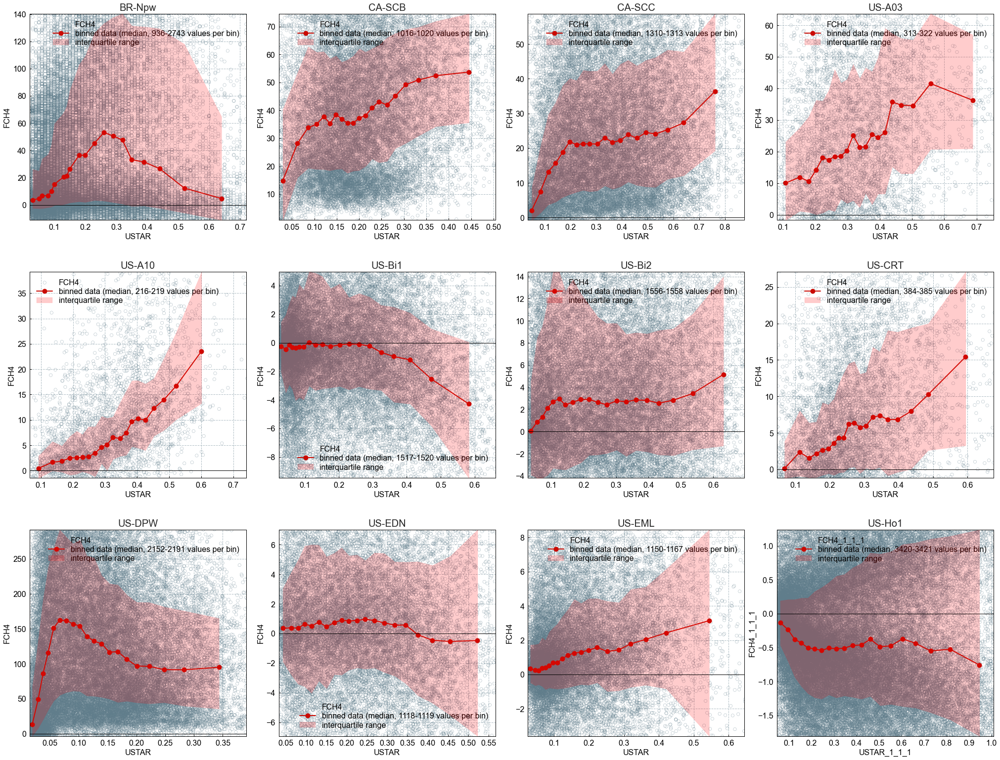

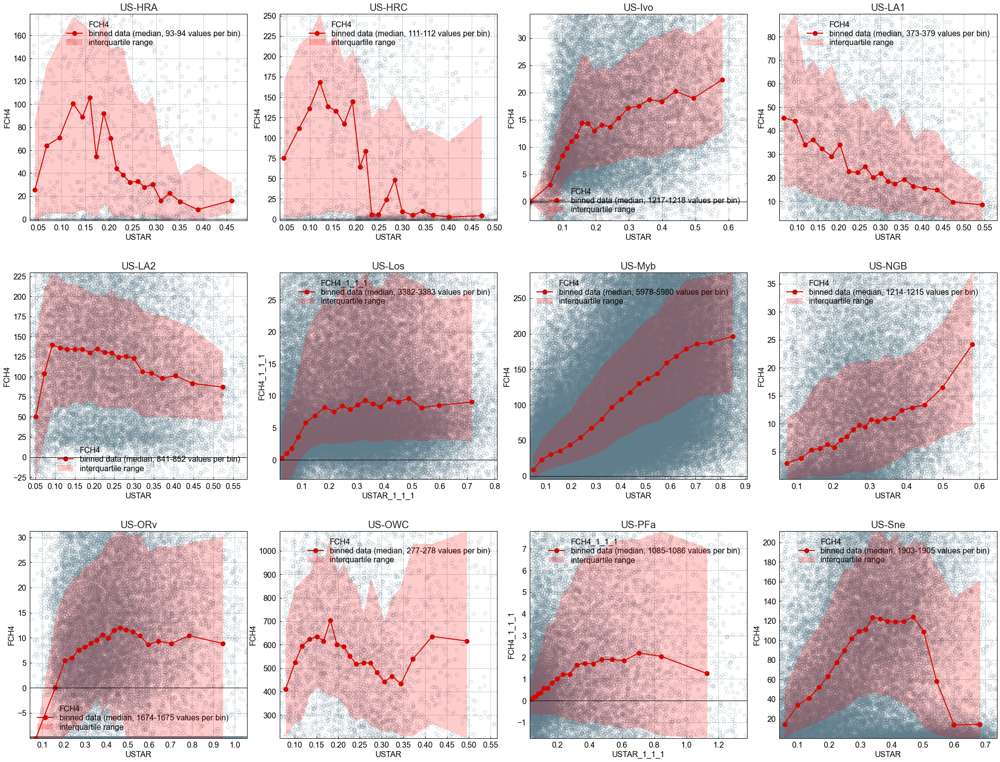

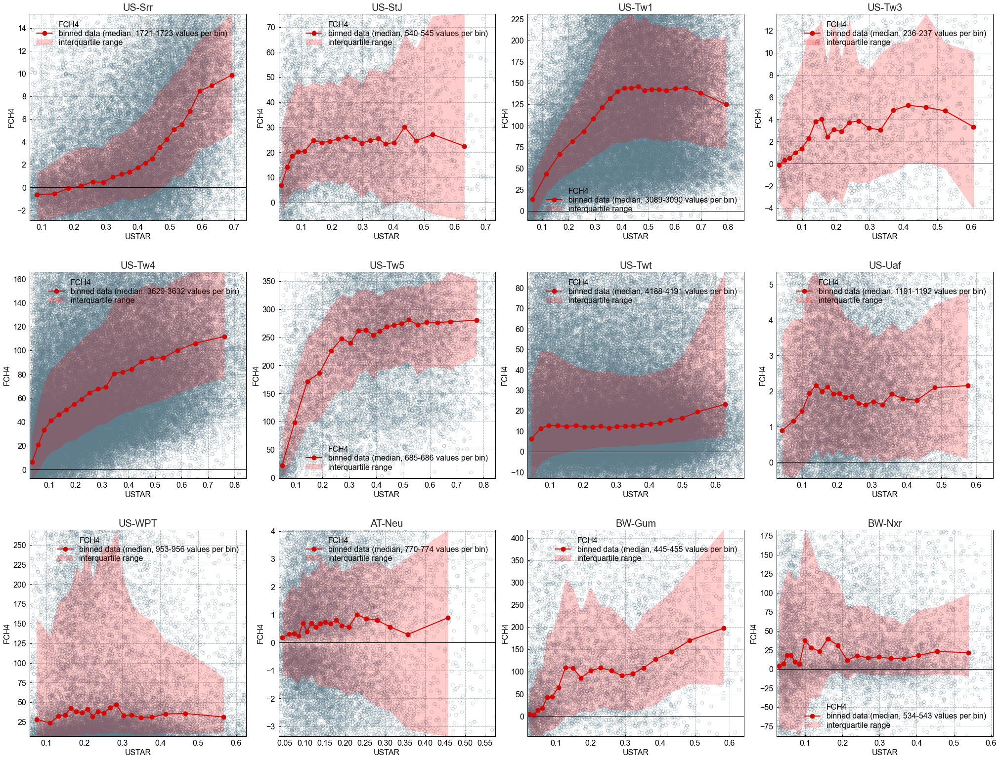

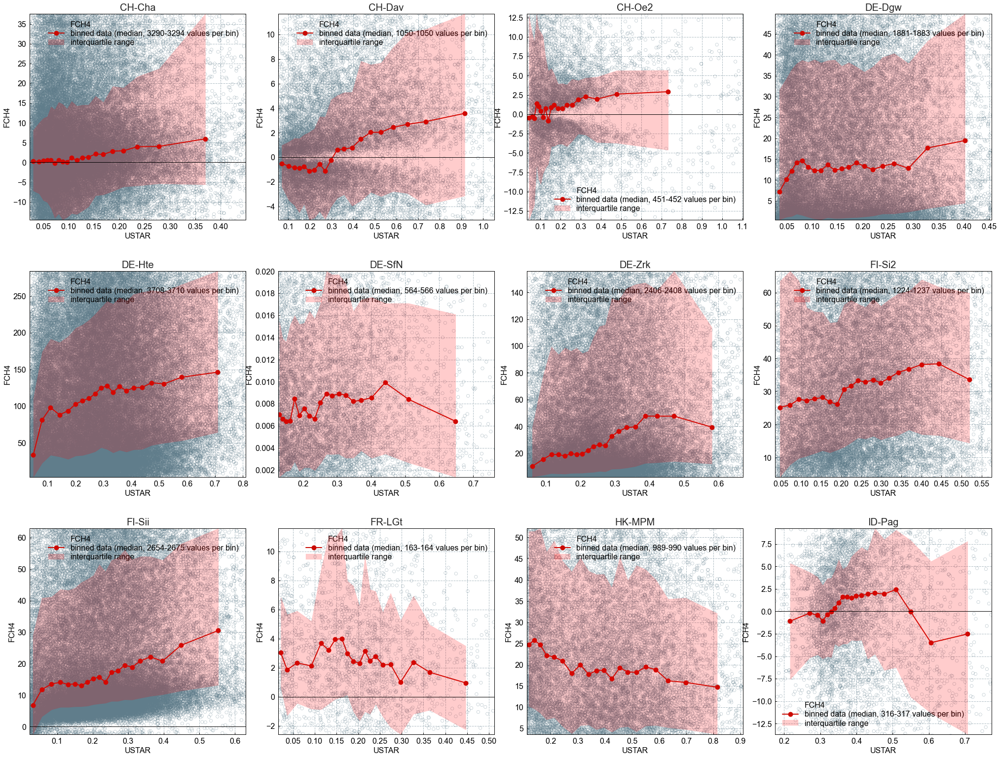

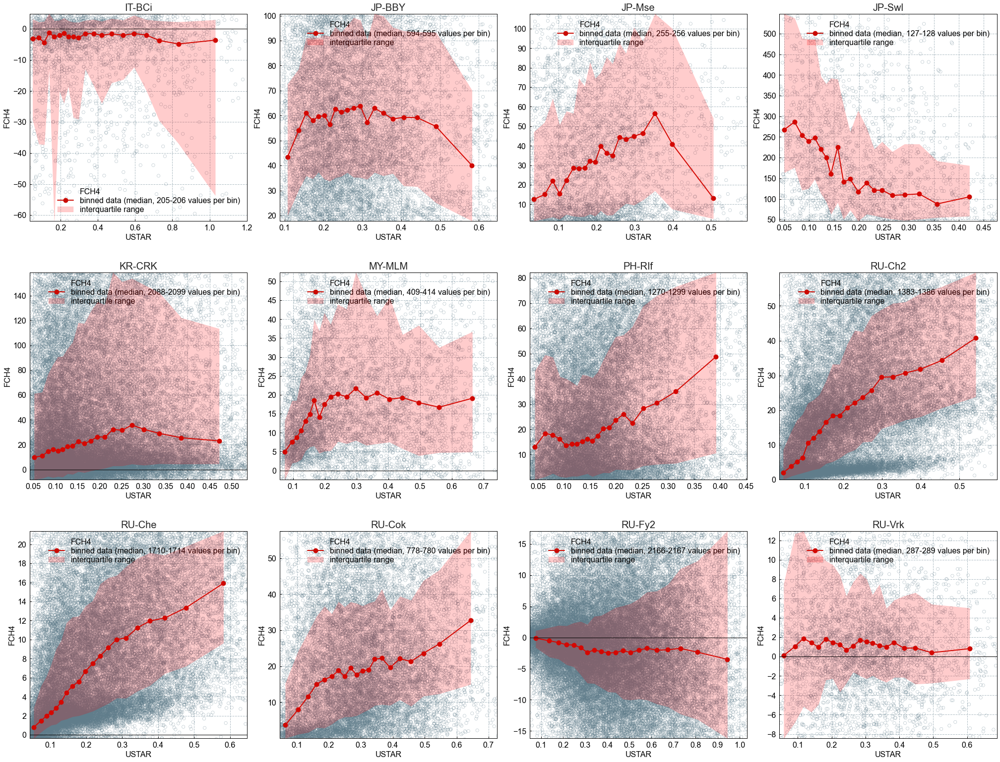

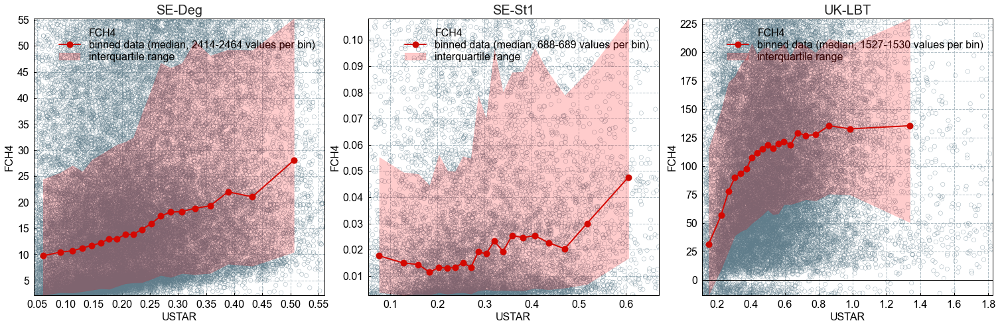

In [22]:
patch = 0
for firstfile in range(0, n_files, 12):    
    patch += 1
    lastfile = firstfile + 12
    print(f"Patch {patch} ({firstfile}-{lastfile})")
    plot(foundfiles=foundfiles[firstfile:lastfile], patchid=patch)    